<a href="https://colab.research.google.com/github/vuongngo1234/Ai-learning/blob/main/nhandienkhuonmat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import matplotlib.pyplot as plt
from matplotlib.image import imread
from os import listdir
from numpy import asarray
from numpy import save
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.models import Sequential
from keras.layers import Dense, Activation, BatchNormalization, Dropout, Conv2D, MaxPooling2D, Flatten
import matplotlib.pyplot as plt
from tensorflow.keras.utils import load_img, img_to_array
import numpy as np

#mount drive vao code
#from google.colab import drive
#drive.mount('/content/drive/MyDrive/anh')

In [2]:
from os import listdir 
from os.path import isdir
from numpy import asarray
from numpy import save
from keras.utils import to_categorical, load_img, img_to_array

folder = '/content/drive/MyDrive/anh'
photos, labels = list(), list()

# loop through all files in the folder
for file in listdir(folder):
    # determine the class
    if file.startswith('vuong'):
        output = 1
    elif file.startswith('tuankiet'):
        output = 2
    elif file.startswith('thanh'):
        output = 3
    elif file.startswith('Duc'):
        output = 4
    else:
        continue
        
    # load image
    photo = load_img(folder + '/' + file, target_size=(200, 200))
    # convert to numpy array
    photo = img_to_array(photo)
    # store
    photos.append(photo)
    labels.append(output)

# convert to numpy arrays
photos = asarray(photos)
labels = asarray(labels)

# one-hot encode labels
labels = to_categorical(labels)

# save arrays to files
save('anh_photos.npy', photos)
save('anh_labels.npy', labels)


In [3]:
from os import listdir
from os.path import isdir
from numpy import asarray
from numpy import save
from keras.utils import load_img, img_to_array
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# load all images in a directory
def load_images(folder):
  photos, labels = list(), list()
  for file in listdir(folder):
    output = 0.0
    if file.startswith('vuong '):
      output = 1
    if file.startswith('tuankiet '):
      output = 2
    if file.startswith('thanh '):
      output = 3
    if file.startswith('Duc '):
      output = 4
    # load image
    photo = load_img(folder + '/' + file, target_size=(200, 200))
    # convert to numpy array
    photo = img_to_array(photo)
    # store
    photos.append(photo)
    labels.append(output)
  # convert to a numpy arrays
  photos = asarray(photos)
  labels = asarray(labels)
  return photos, labels

# define the model
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', input_shape=(200, 200, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(5, activation='softmax'))

# compile the model
model.compile(optimizer='Adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# load the data
folder = '/content/drive/MyDrive/anh'
photos, labels = load_images(folder)

# split the data into training and testing sets
trainX, testX, trainY, testY = train_test_split(photos, labels, test_size=0.1, random_state=1)

# train the model
history = model.fit(trainX, trainY, validation_data=(testX, testY), epochs=20, verbose=1)

# evaluate the model
test_loss, test_acc = model.evaluate(testX, testY)
print('Test accuracy: %.2f%%' % (test_acc * 100))


Epoch 1/20
3/3 [==============================] - 13s 562ms/step - loss: 719.9891 - accuracy: 0.2778 - val_loss: 3675.9507 - val_accuracy: 0.0000e+00
Epoch 2/20
3/3 [==============================] - 0s 53ms/step - loss: 1800.8610 - accuracy: 0.2778 - val_loss: 356.5541 - val_accuracy: 0.3000
Epoch 3/20
3/3 [==============================] - 0s 59ms/step - loss: 231.0072 - accuracy: 0.6111 - val_loss: 55.7966 - val_accuracy: 0.5000
Epoch 4/20
3/3 [==============================] - 0s 54ms/step - loss: 45.5816 - accuracy: 0.4444 - val_loss: 13.4836 - val_accuracy: 0.3000
Epoch 5/20
3/3 [==============================] - 0s 67ms/step - loss: 7.7591 - accuracy: 0.8000 - val_loss: 18.9663 - val_accuracy: 0.8000
Epoch 6/20
3/3 [==============================] - 0s 69ms/step - loss: 4.3679 - accuracy: 0.9000 - val_loss: 15.1848 - val_accuracy: 0.7000
Epoch 7/20
3/3 [==============================] - 0s 69ms/step - loss: 1.1409 - accuracy: 0.9000 - val_loss: 11.4474 - val_accuracy: 0.8000
Epo

In [4]:
from keras.models import load_model
model.save("anh.h5")
model_1=load_model('anh.h5')

In [5]:
model.save('anh.h5')


1/1 [==============================] - 0s 31ms/step
[1]


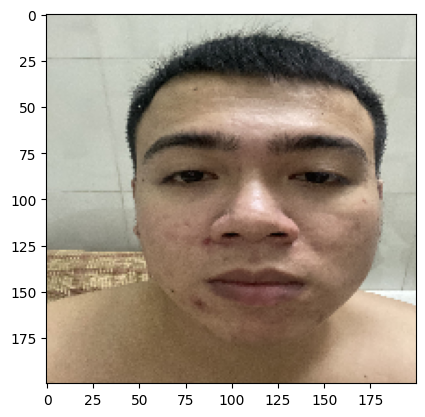

1/1 [==============================] - 0s 30ms/step
[2]


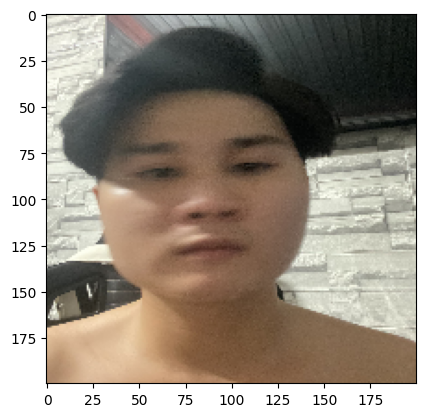

1/1 [==============================] - 0s 30ms/step
[2]


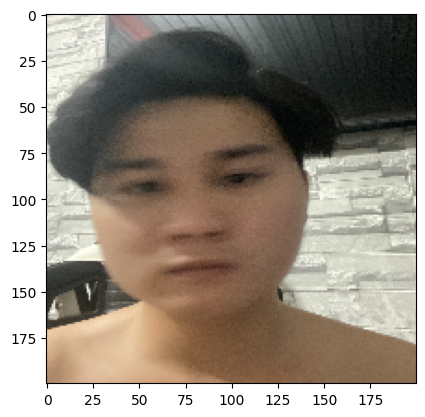

1/1 [==============================] - 0s 27ms/step
[2]


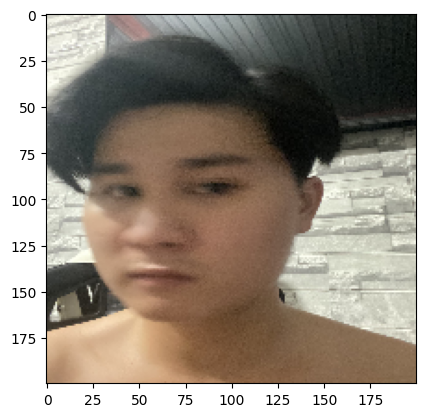

1/1 [==============================] - 0s 28ms/step
[2]


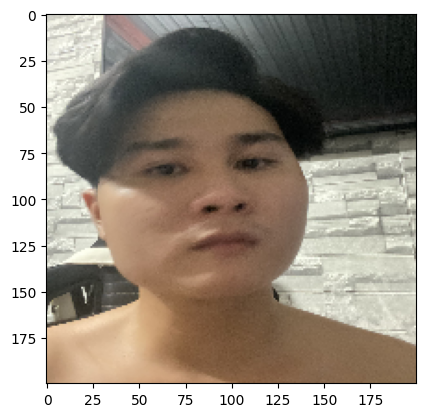

1/1 [==============================] - 0s 19ms/step
[2]


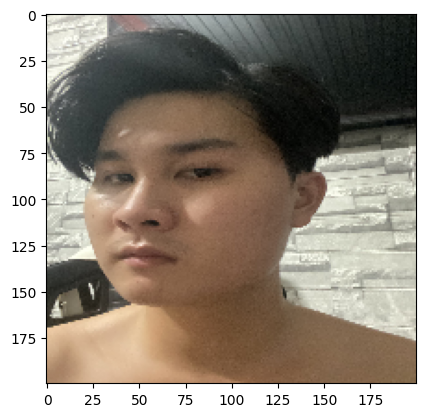

1/1 [==============================] - 0s 19ms/step
[2]


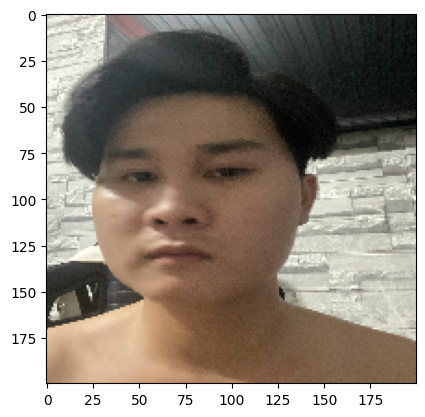

1/1 [==============================] - 0s 20ms/step
[2]


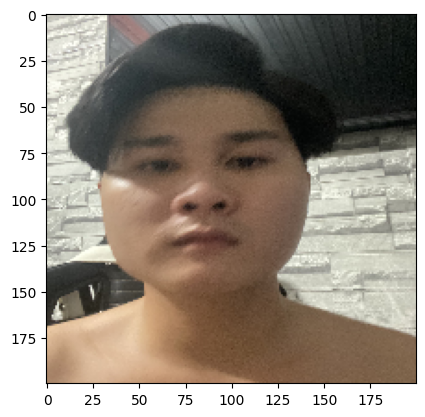

1/1 [==============================] - 0s 22ms/step
[2]


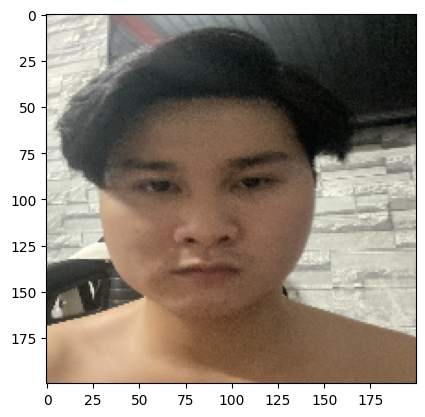

1/1 [==============================] - 0s 21ms/step
[2]


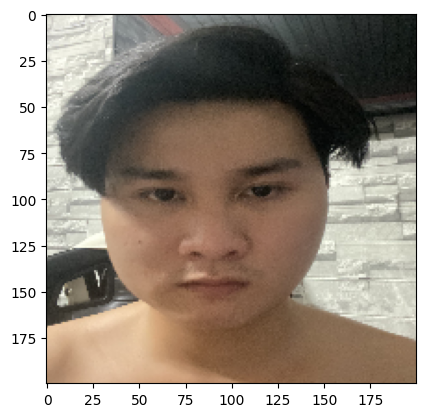

1/1 [==============================] - 0s 23ms/step
[2]


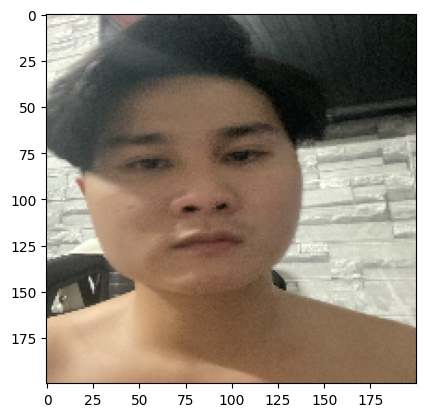

1/1 [==============================] - 0s 22ms/step
[2]


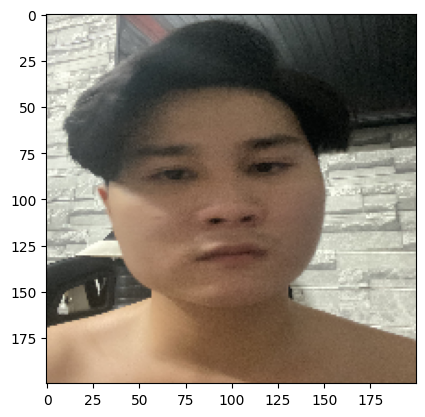

1/1 [==============================] - 0s 23ms/step
[2]


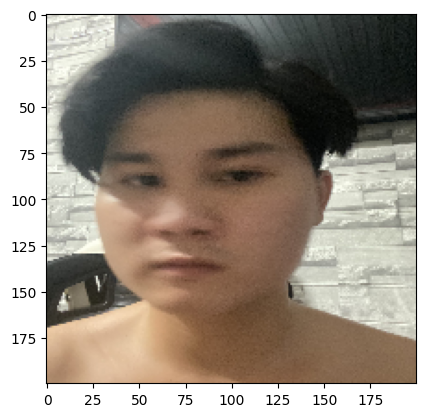

1/1 [==============================] - 0s 21ms/step
[2]


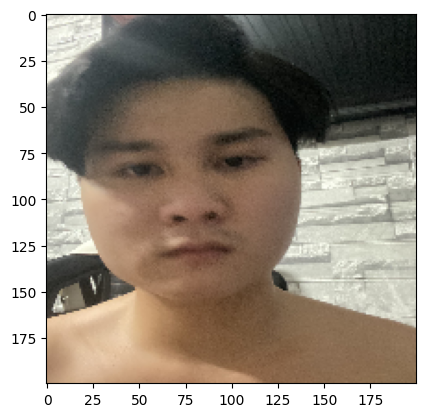

1/1 [==============================] - 0s 19ms/step
[2]


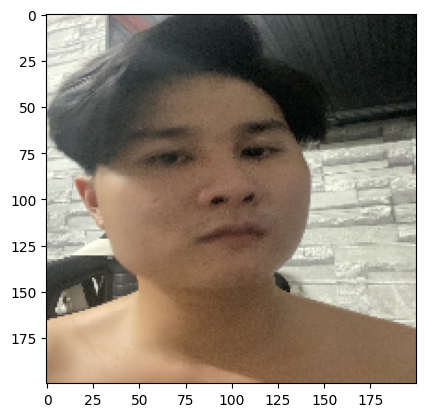

1/1 [==============================] - 0s 20ms/step
[2]


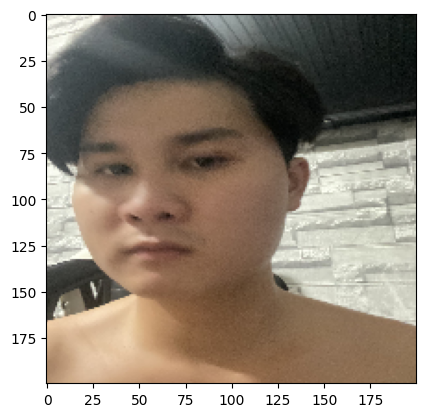

1/1 [==============================] - 0s 30ms/step
[2]


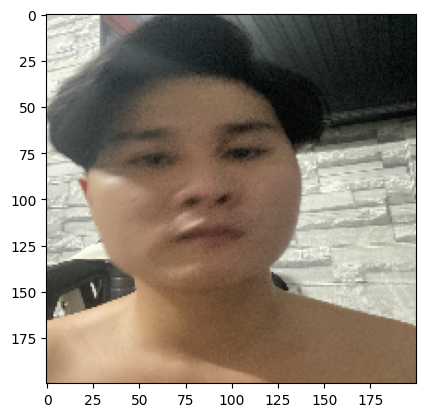

1/1 [==============================] - 0s 20ms/step
[2]


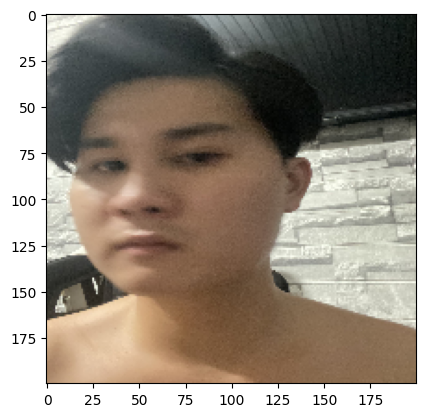

1/1 [==============================] - 0s 20ms/step
[2]


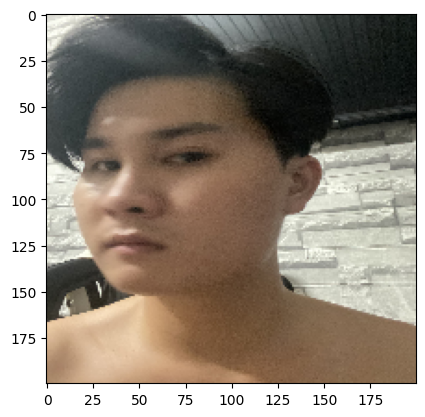

1/1 [==============================] - 0s 22ms/step
[2]


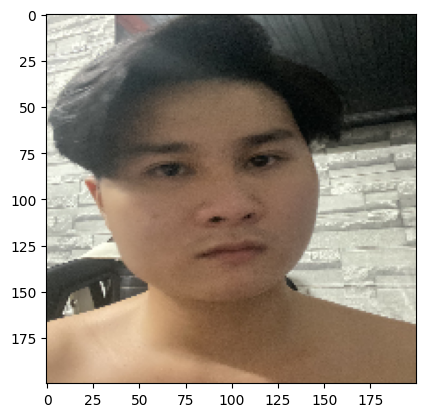

1/1 [==============================] - 0s 19ms/step
[2]


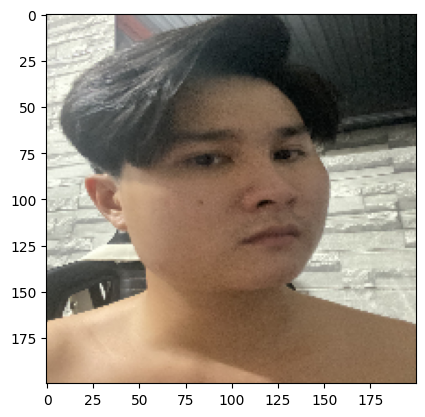

1/1 [==============================] - 0s 29ms/step
[2]


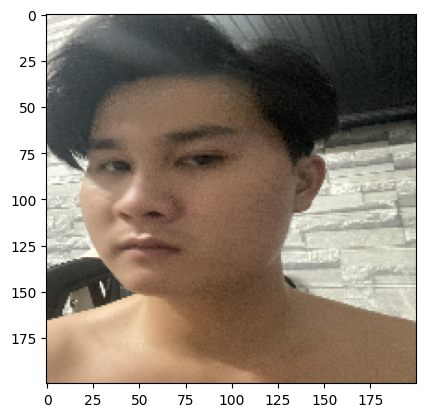

1/1 [==============================] - 0s 26ms/step
[2]


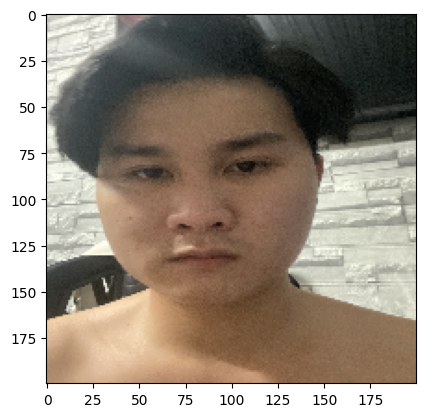

1/1 [==============================] - 0s 26ms/step
[2]


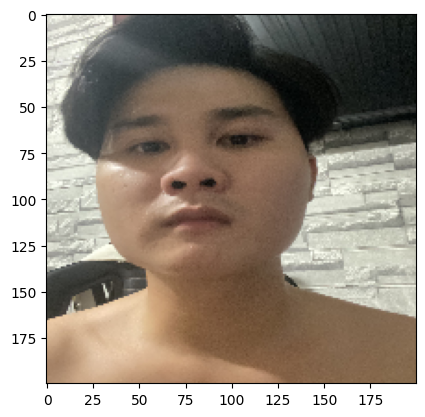

1/1 [==============================] - 0s 21ms/step
[2]


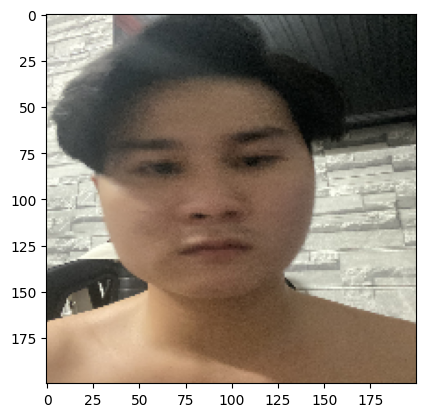

1/1 [==============================] - 0s 30ms/step
[2]


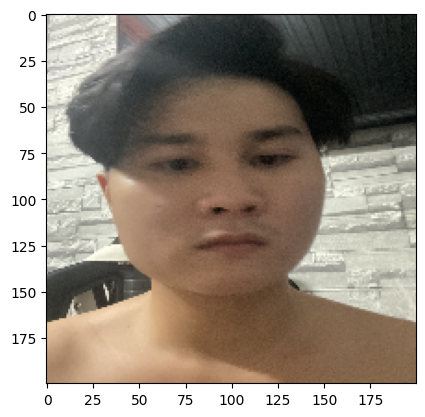

1/1 [==============================] - 0s 31ms/step
[2]


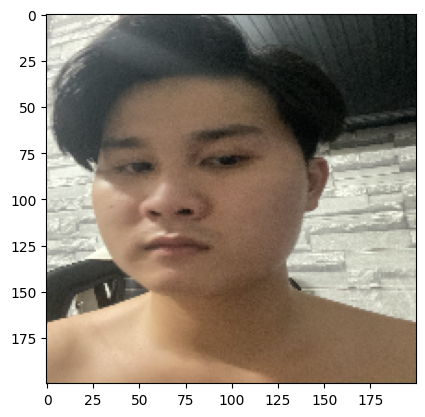

1/1 [==============================] - 0s 30ms/step
[2]


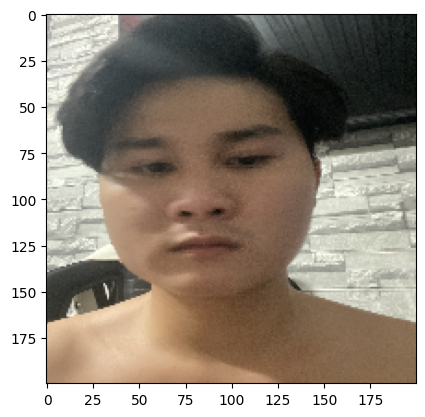

1/1 [==============================] - 0s 29ms/step
[2]


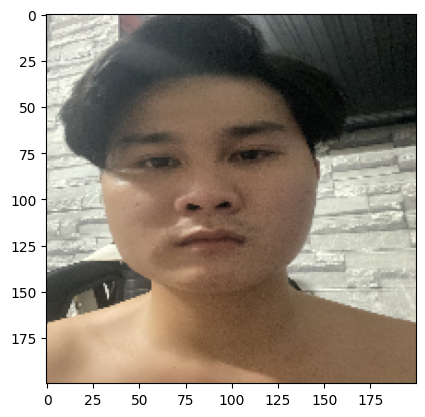

1/1 [==============================] - 0s 28ms/step
[2]


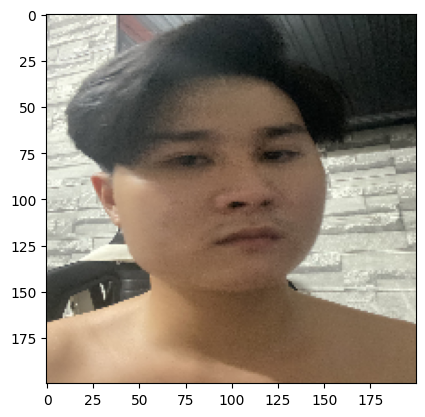

1/1 [==============================] - 0s 65ms/step
[2]


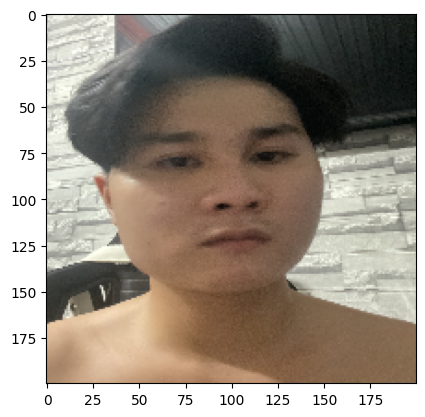

1/1 [==============================] - 0s 32ms/step
[2]


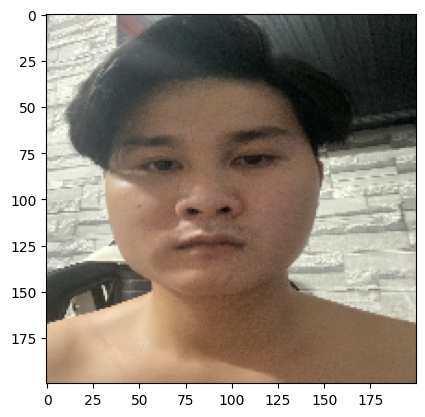

1/1 [==============================] - 0s 37ms/step
[2]


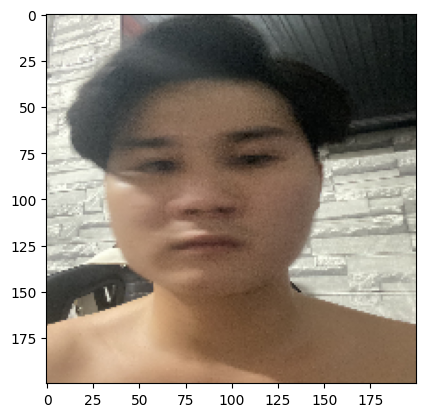

1/1 [==============================] - 0s 36ms/step
[2]


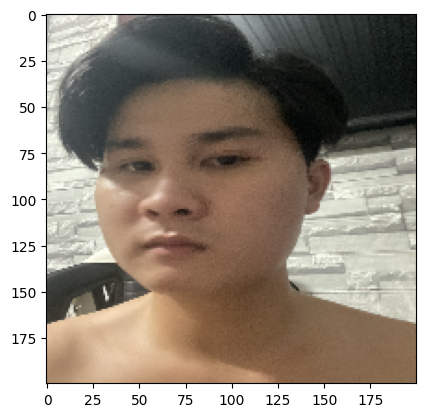

1/1 [==============================] - 0s 66ms/step
[2]


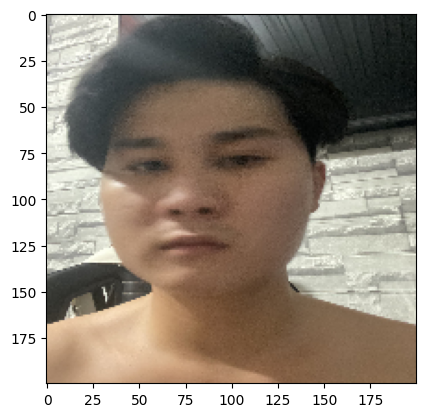

1/1 [==============================] - 0s 37ms/step
[2]


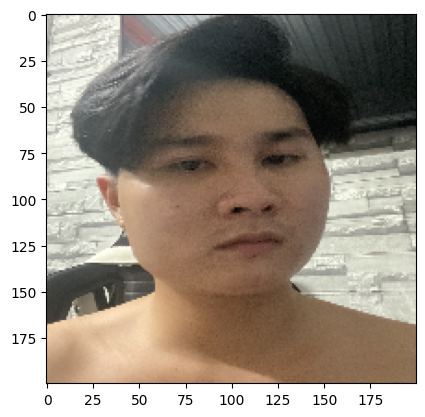

1/1 [==============================] - 0s 35ms/step
[2]


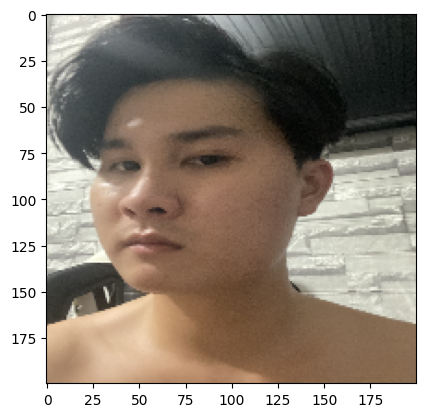

1/1 [==============================] - 0s 28ms/step
[2]


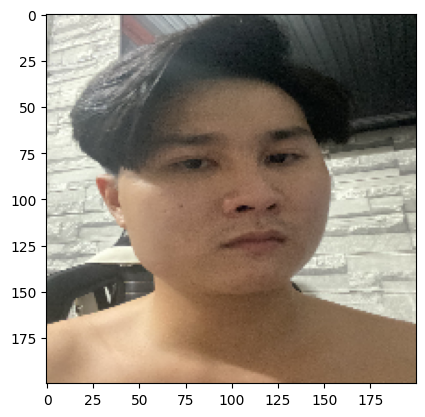

1/1 [==============================] - 0s 28ms/step
[2]


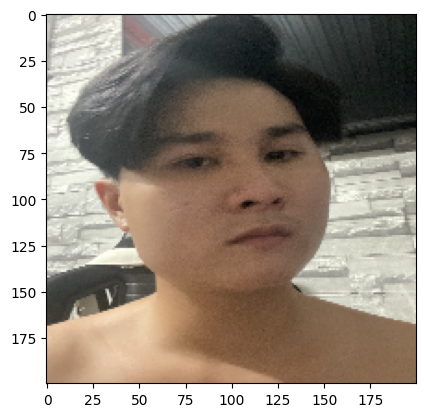

1/1 [==============================] - 0s 44ms/step
[2]


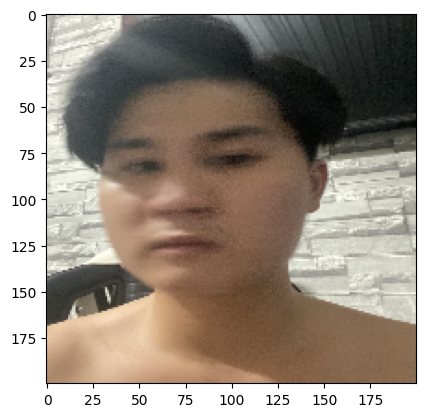

1/1 [==============================] - 0s 28ms/step
[2]


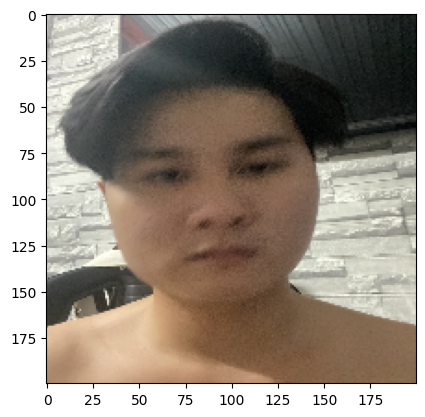

1/1 [==============================] - 0s 26ms/step
[2]


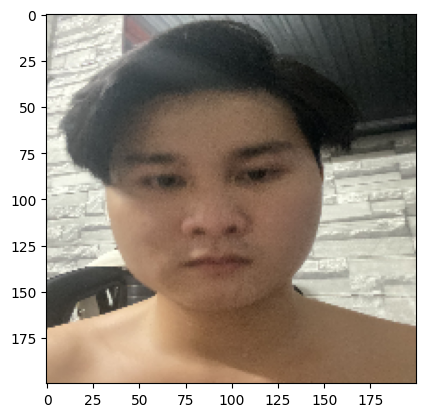

1/1 [==============================] - 0s 30ms/step
[2]


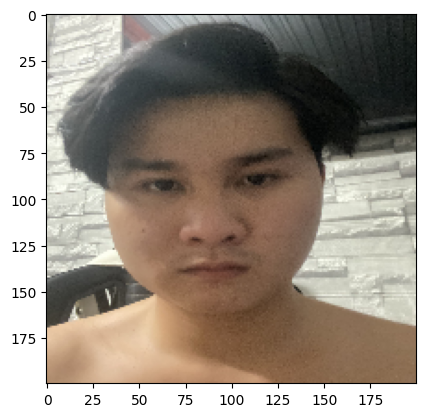

1/1 [==============================] - 0s 32ms/step
[2]


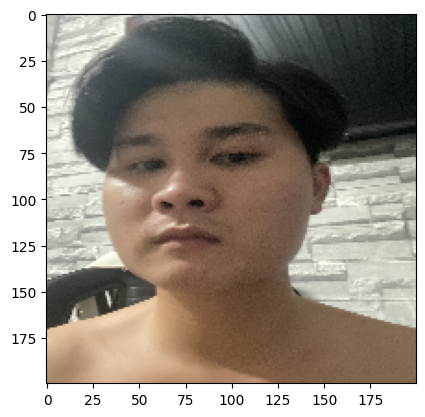

1/1 [==============================] - 0s 29ms/step
[2]


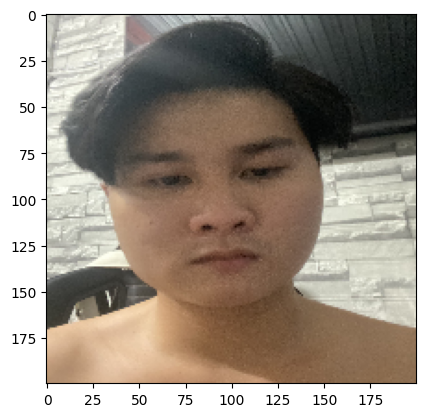

1/1 [==============================] - 0s 28ms/step
[2]


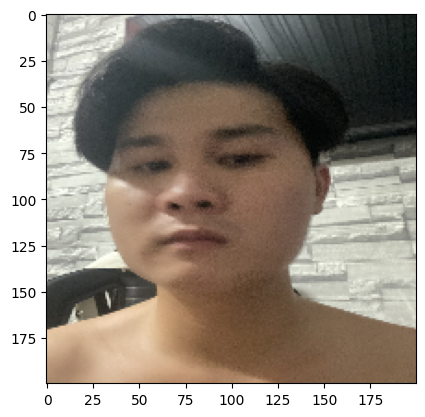

1/1 [==============================] - 0s 28ms/step
[2]


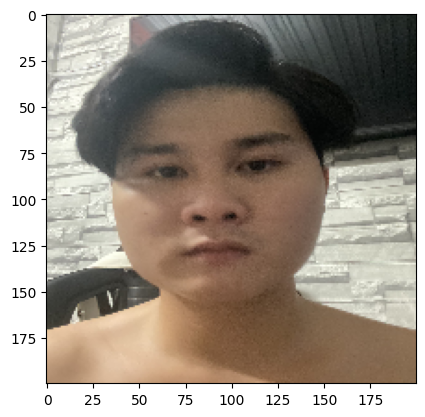

1/1 [==============================] - 0s 26ms/step
[2]


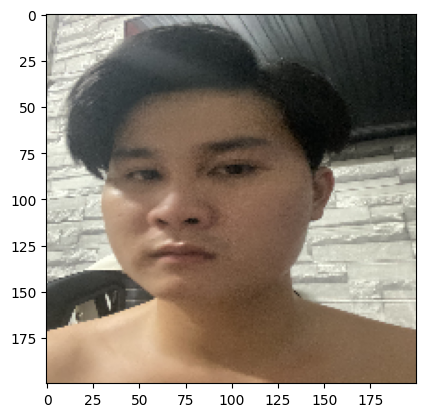

1/1 [==============================] - 0s 28ms/step
[2]


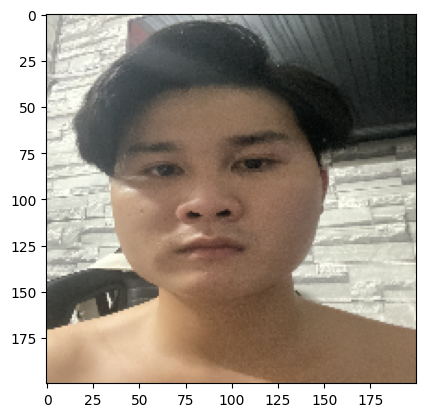

1/1 [==============================] - 0s 29ms/step
[2]


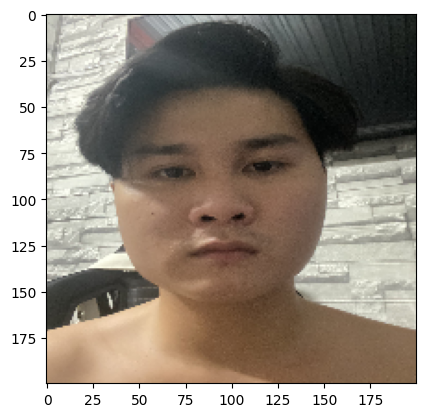

1/1 [==============================] - 0s 29ms/step
[2]


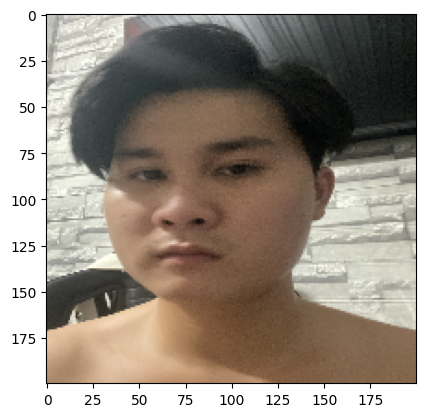

1/1 [==============================] - 0s 30ms/step
[1]


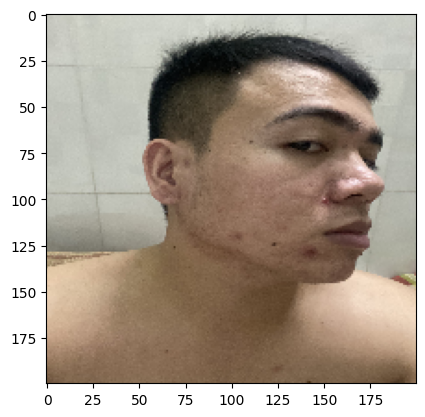

1/1 [==============================] - 0s 27ms/step
[1]


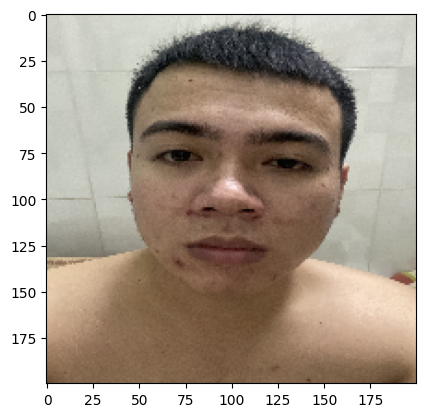

1/1 [==============================] - 0s 27ms/step
[1]


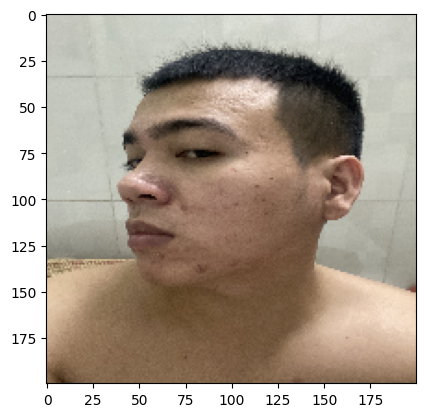

1/1 [==============================] - 0s 45ms/step
[1]


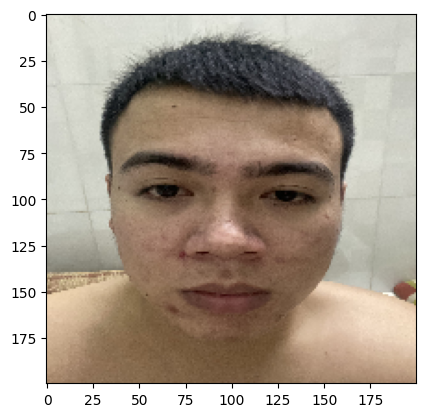

1/1 [==============================] - 0s 63ms/step
[1]


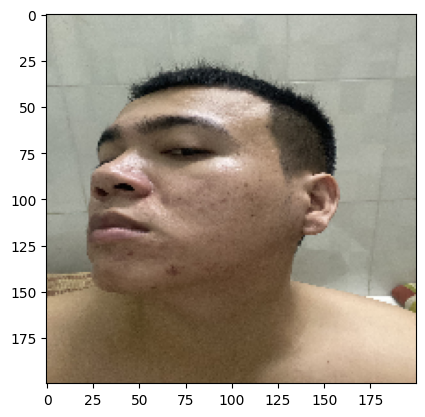

1/1 [==============================] - 0s 27ms/step
[1]


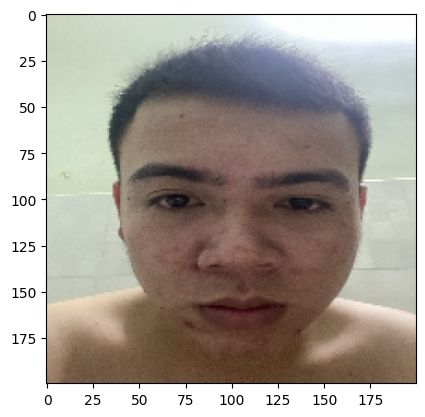

1/1 [==============================] - 0s 29ms/step
[1]


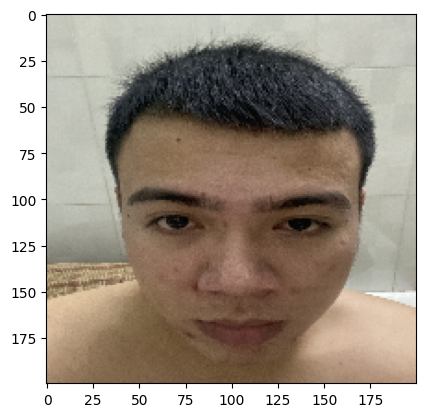

1/1 [==============================] - 0s 58ms/step
[1]


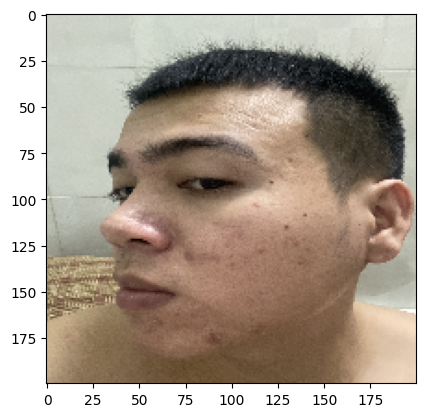

1/1 [==============================] - 0s 33ms/step
[1]


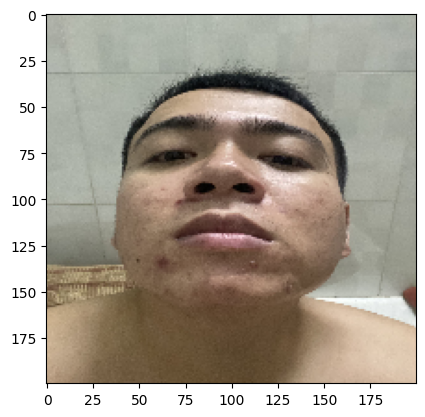

1/1 [==============================] - 0s 27ms/step
[1]


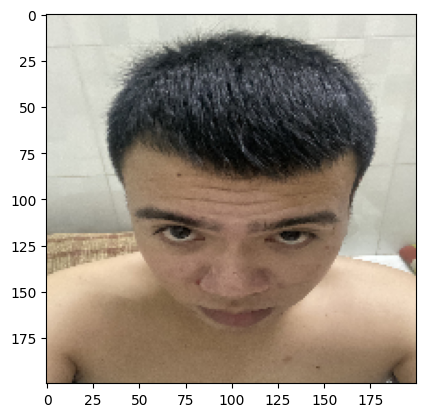

1/1 [==============================] - 0s 32ms/step
[1]


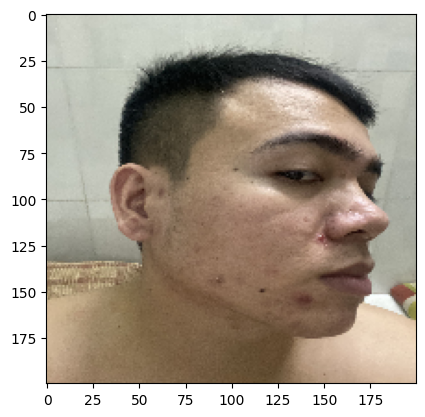

1/1 [==============================] - 0s 29ms/step
[1]


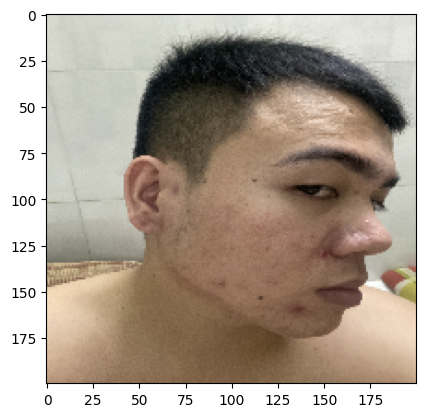

1/1 [==============================] - 0s 55ms/step
[4]


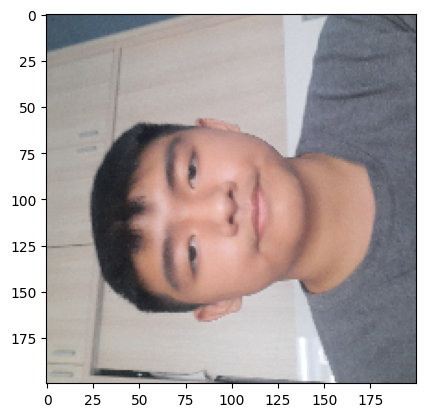

1/1 [==============================] - 0s 37ms/step
[0]


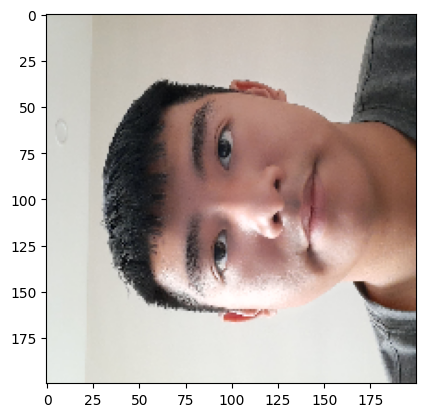

1/1 [==============================] - 0s 28ms/step
[0]


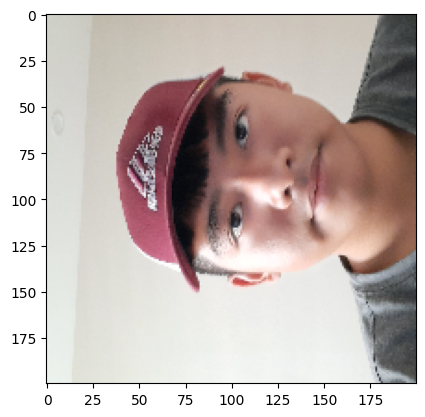

1/1 [==============================] - 0s 25ms/step
[4]


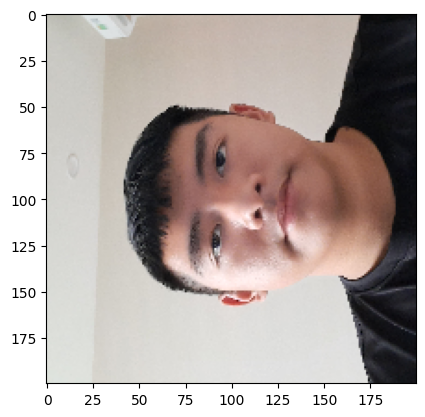

1/1 [==============================] - 0s 33ms/step
[4]


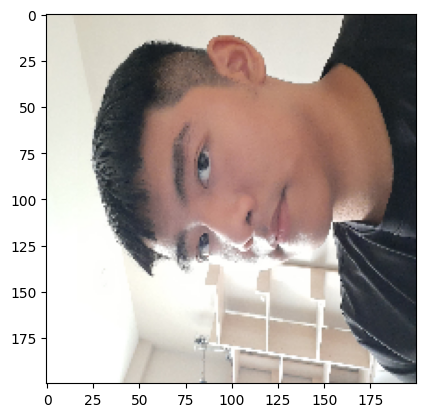

1/1 [==============================] - 0s 32ms/step
[4]


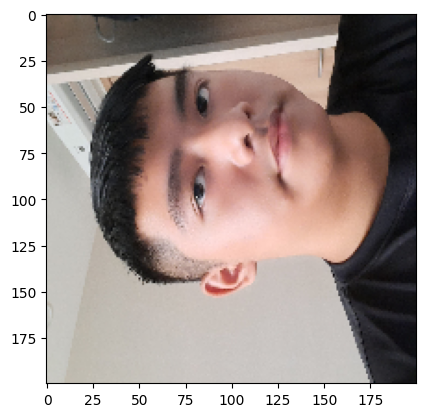

1/1 [==============================] - 0s 30ms/step
[4]


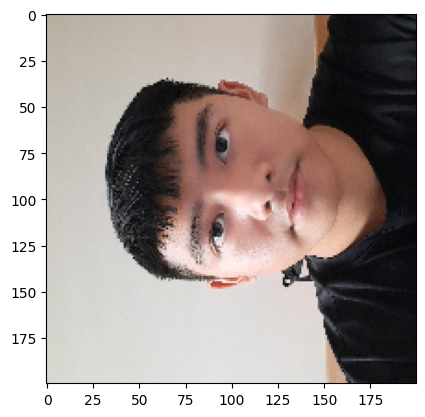

1/1 [==============================] - 0s 33ms/step
[4]


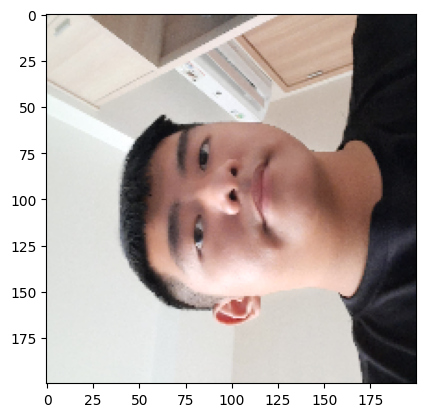

1/1 [==============================] - 0s 27ms/step
[4]


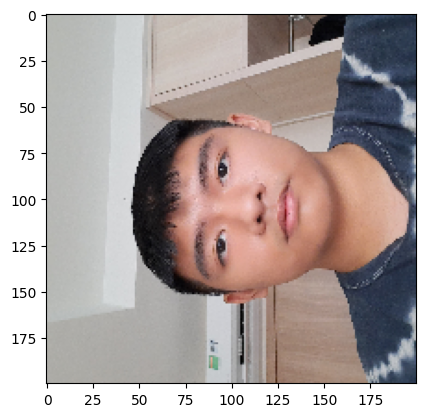

1/1 [==============================] - 0s 30ms/step
[4]


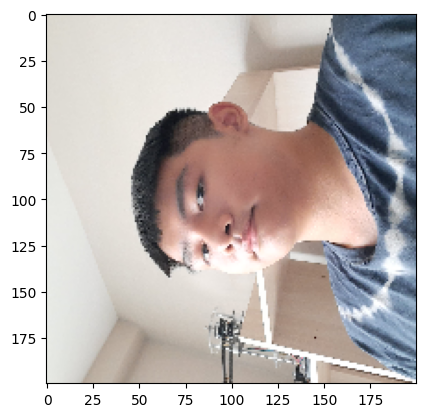

1/1 [==============================] - 0s 30ms/step
[4]


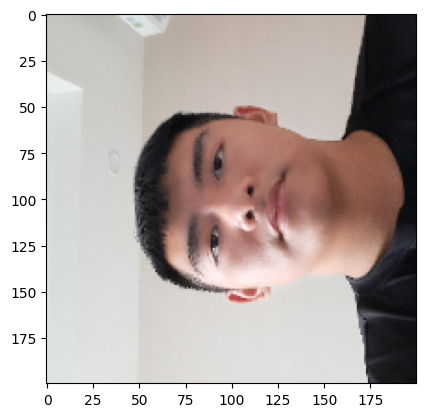

1/1 [==============================] - 0s 28ms/step
[0]


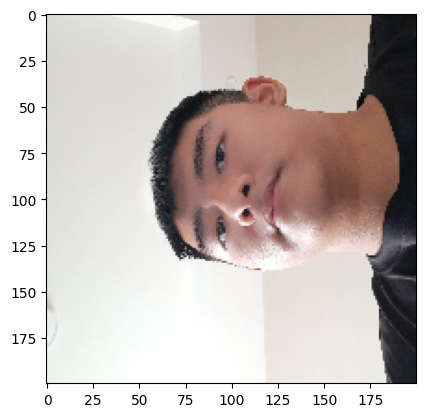

1/1 [==============================] - 0s 28ms/step
[3]


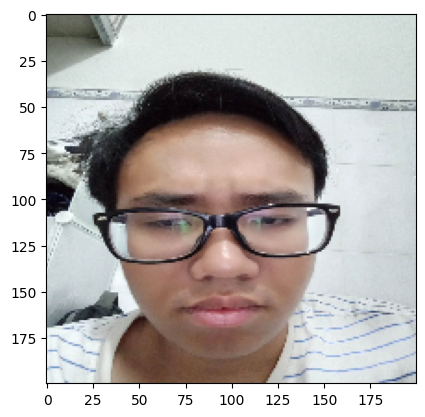

1/1 [==============================] - 0s 28ms/step
[3]


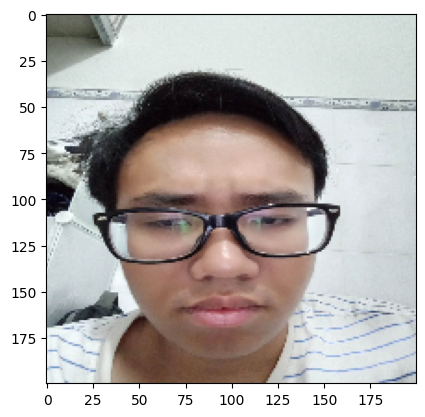

1/1 [==============================] - 0s 28ms/step
[3]


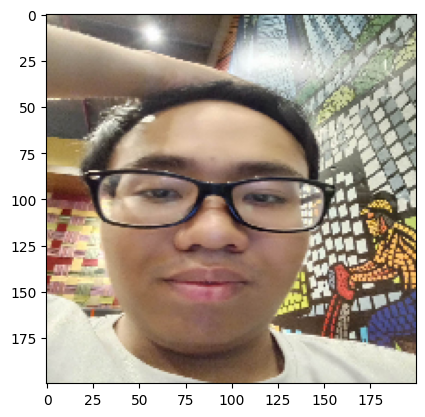

1/1 [==============================] - 0s 27ms/step
[3]


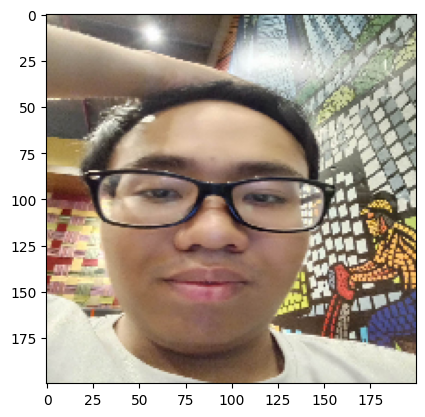

1/1 [==============================] - 0s 28ms/step
[3]


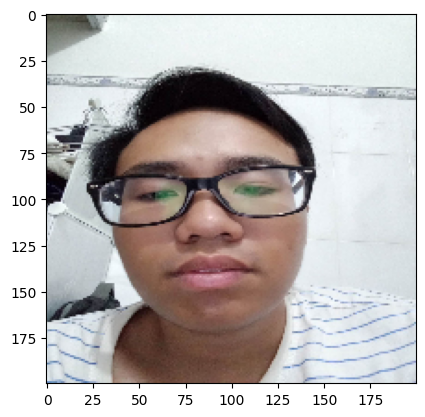

1/1 [==============================] - 0s 29ms/step
[3]


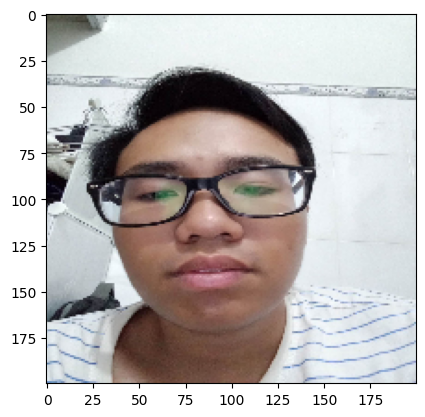

1/1 [==============================] - 0s 34ms/step
[3]


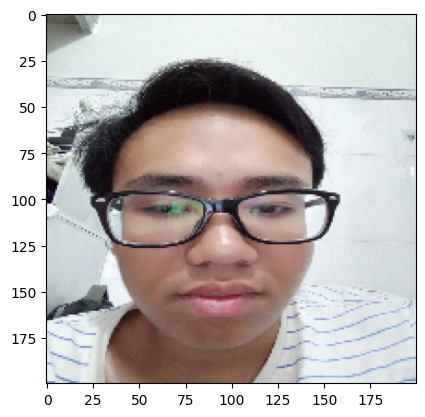

1/1 [==============================] - 0s 55ms/step
[3]


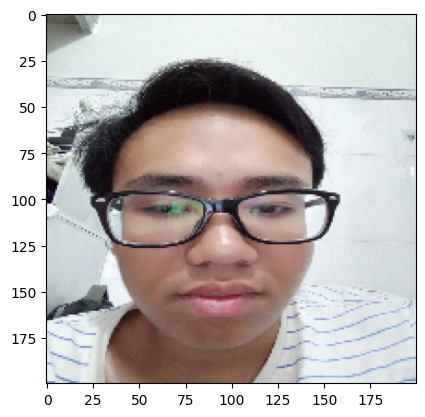

1/1 [==============================] - 0s 35ms/step
[3]


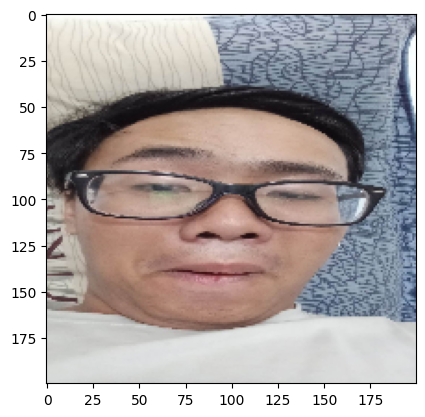

1/1 [==============================] - 0s 28ms/step
[3]


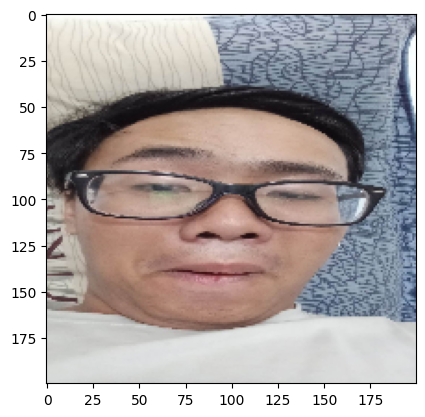

1/1 [==============================] - 0s 39ms/step
[3]


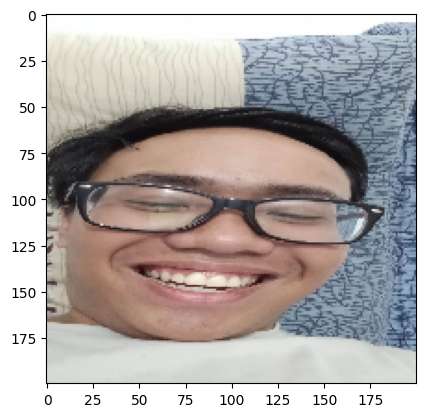

1/1 [==============================] - 0s 56ms/step
[3]


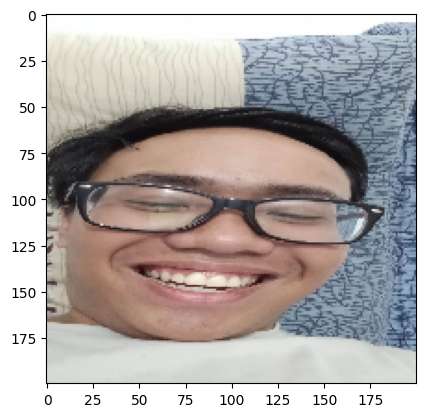

1/1 [==============================] - 0s 28ms/step
[3]


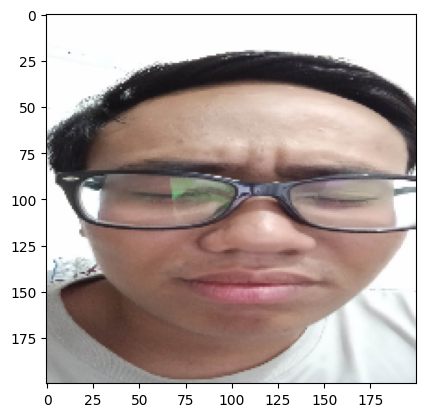

1/1 [==============================] - 0s 32ms/step
[3]


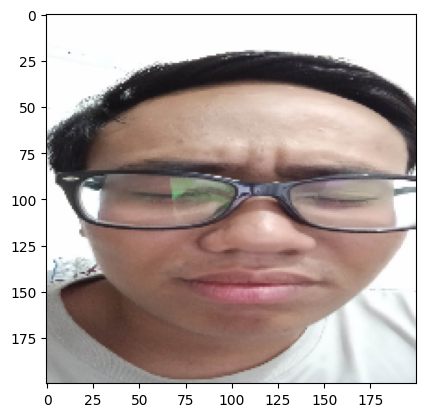

1/1 [==============================] - 0s 35ms/step
[3]


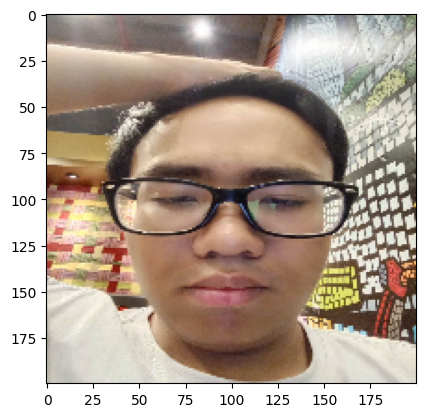

1/1 [==============================] - 0s 35ms/step
[3]


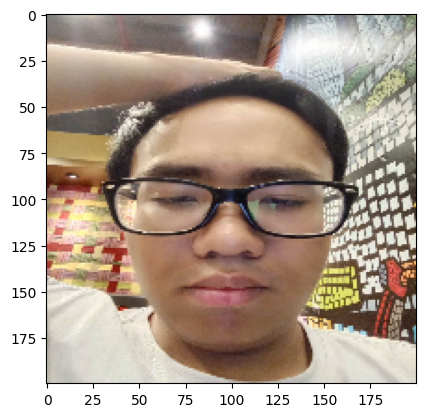

1/1 [==============================] - 0s 40ms/step
[3]


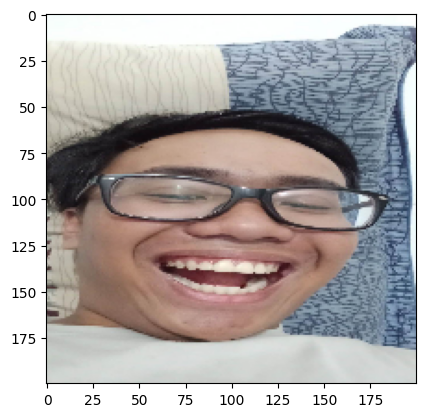

1/1 [==============================] - 0s 28ms/step
[3]


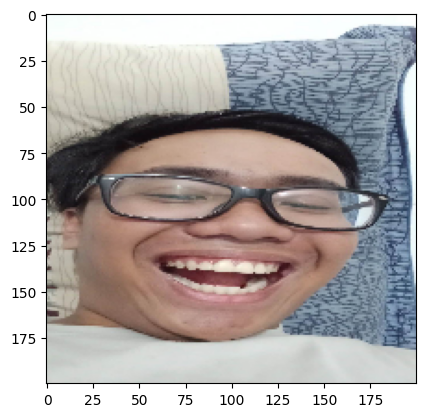

1/1 [==============================] - 0s 25ms/step
[0]


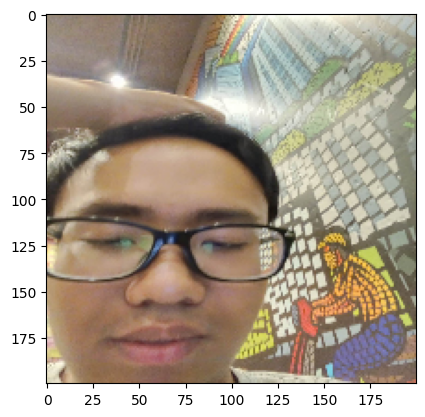

1/1 [==============================] - 0s 27ms/step
[0]


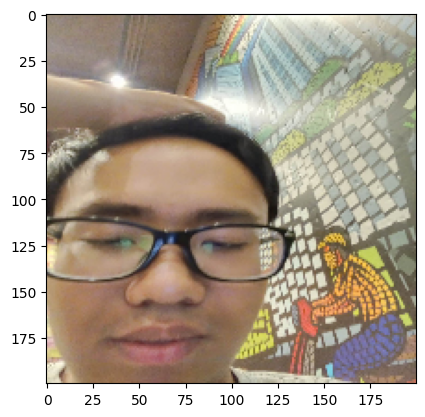

1/1 [==============================] - 0s 25ms/step
[1]


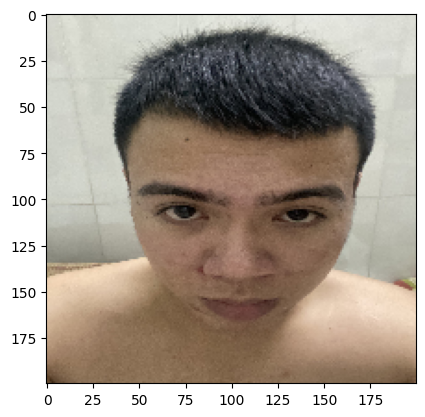

1/1 [==============================] - 0s 33ms/step
[1]


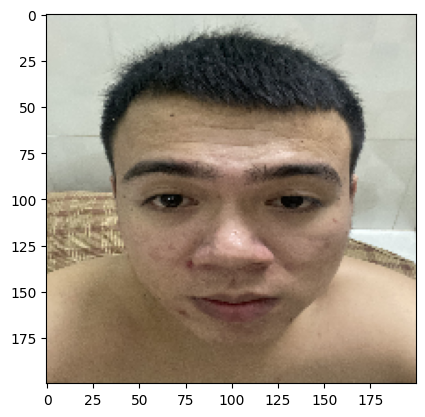

1/1 [==============================] - 0s 41ms/step
[1]


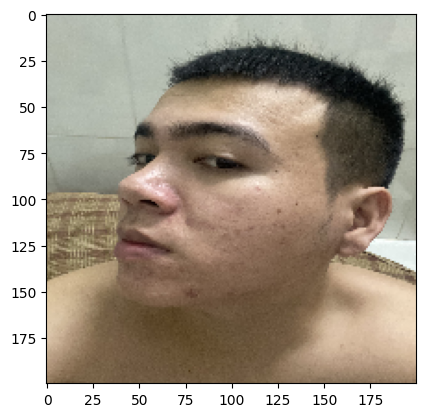

1/1 [==============================] - 0s 27ms/step
[1]


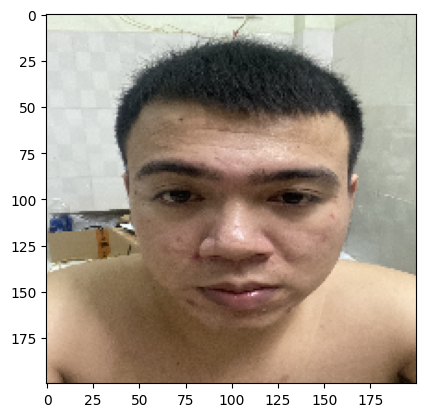

1/1 [==============================] - 0s 26ms/step
[0]


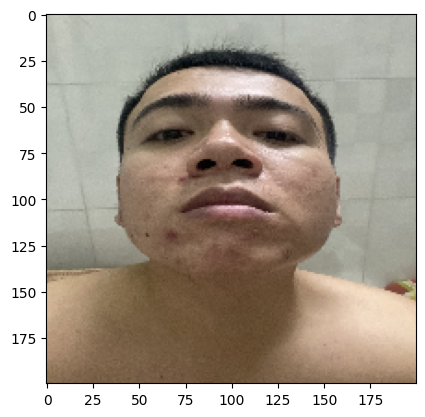

In [11]:
from keras.models import load_model
from keras.utils import load_img, img_to_array
import os
import numpy as np 
import matplotlib.pyplot as plt


# Define the class names in the same order as the model output
class_names = ['vuong', 'tuankiet', 'Duc', 'thanh']

# Loop through the images in the test directory
test_dir = '/content/drive/MyDrive/anh'
for img_file in os.listdir(test_dir):
    # Load the image and preprocess it
    img = load_img(os.path.join(test_dir, img_file), target_size=(200, 200))
    plt.imshow(img)
    img = img_to_array(img) 
    img = img.astype('float32') 
    img /= 255 
    img = np.expand_dims(img, axis=0)
    
    # Use the model to predict the class of the image
    pred = model.predict(img)
    result = np.argmax(pred)
    class_name =[result]
    
    # Print the predicted class and display the image
    print([result])
    plt.show()
